### Import libs

In [10]:
## import libs
from __future__ import print_function
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import os
import sys
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
import warnings
warnings.filterwarnings("ignore")
import numpy as np
from models import *
import torch
import torch.optim
import time
from skimage.measure import compare_psnr
from utils.inpainting_utils import * 
import _pickle as cPickle
torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor


## display images
def np_plot(np_matrix, title, opt = 'RGB'):
    plt.figure(2)
    plt.clf()
    if opt == 'RGB':
        fig = plt.imshow(np_matrix.transpose(1, 2, 0), interpolation = 'nearest')
    elif opt == 'map':
        fig = plt.imshow(np_matrix, interpolation = 'bilinear', cmap = cm.RdYlGn)
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)
    plt.title(title)
    plt.axis('off')
    plt.pause(0.05) 

### Load image

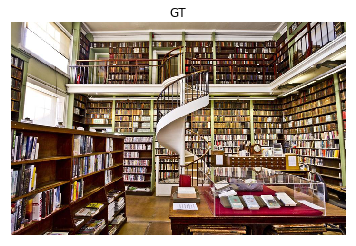

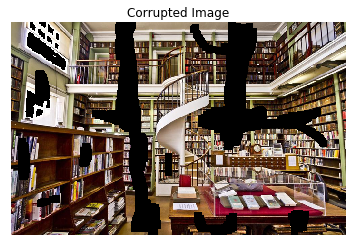

In [2]:
ffname = 'library'
root_dir = 'figs/inpainting/'
dirname = root_dir + ffname
if not os.path.exists(dirname):
    os.makedirs(dirname, exist_ok=True)

data_root = 'data/inpainting/'
img_path = data_root + ffname + '.png'
mask_path = data_root + ffname + '_mask.png'
num_layers = 6

imsize = -1
dim_div_by = 64

img_pil, img_np = get_image(img_path, imsize)
img_mask_pil, img_mask_np = get_image(mask_path, imsize)

img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_pil      = crop_image(img_pil,      dim_div_by)
img_np      = pil_to_np(img_pil)
img_mask_np = pil_to_np(img_mask_pil)

nsize_H, nsize_W = img_np.shape[1], img_np.shape[2]

np_plot(img_np, 'GT')
np_plot(img_np * img_mask_np, 'Corrupted Image')

### Hyper-parameters

In [3]:
## Setup
pad = 'reflection'
OPT_OVER = 'net'
learning_rate = LR = 0.01
exp_weight = 0.99
input_depth = 1
output_depth = 3
INPUT = 'noise'
show_every = 500

## Loss
mse = torch.nn.MSELoss().type(dtype)
img_var = np_to_torch(img_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

### SGD variant 

#### (1) SGD  and (2) SGD + moving average

Starting optimization with ADAM


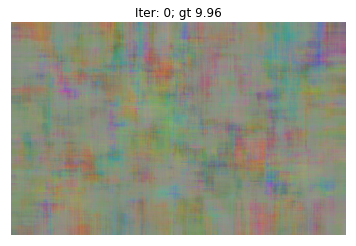

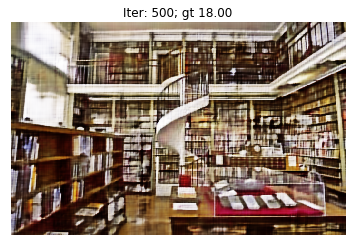

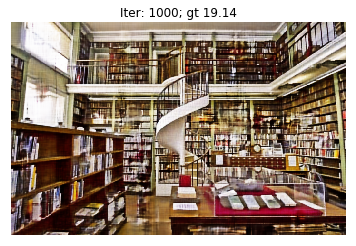

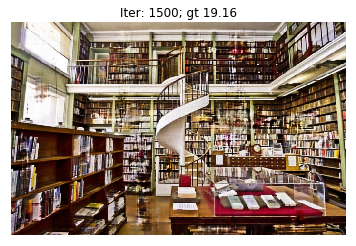

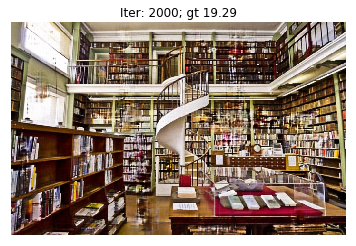

...

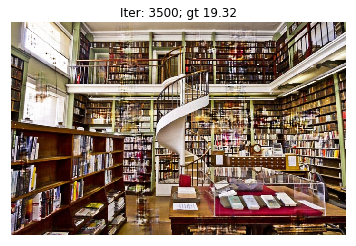

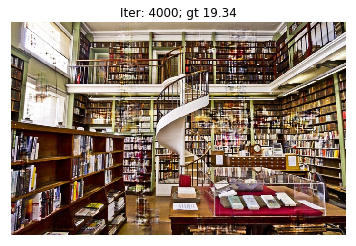

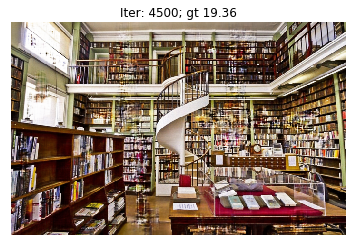

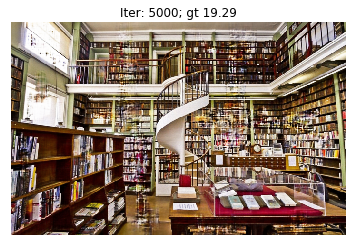

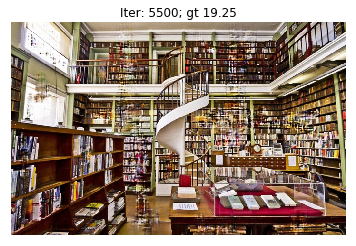

In [4]:
num_iter = 6000
check_point = 3000

net = skip(
    input_depth, output_depth,
    num_channels_down = [16, 32, 64, 128, 128, 128][:num_layers],
    num_channels_up   = [16, 32, 64, 128, 128, 128][:num_layers],
    num_channels_skip = [0]*num_layers,
    upsample_mode='nearest',
    # downsample_mode='avg',
    need1x1_up = False,
    filter_size_down=5, 
    filter_size_up=3,
    filter_skip_size = 1,
    need_sigmoid=True, 
    need_bias=True, 
    pad='reflection', 
    act_fun='LeakyReLU').type(dtype)

net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)
net_input_saved = net_input.detach().clone()

# psnr between sgd out and gt
sgd_psnr_list = [] 
sgd_expm_psnr_list = []

out_avg = None # moving average
sgd_out = None
sgd_expm_out = None

i = 0
def closure_sgd():

    global i, out_avg, sgd_out, sgd_expm_out, check_point

    net_input = net_input_saved
    out = net(net_input)
    # moving average
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)

    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()

    out_np = out.detach().cpu().numpy()[0]
    out_avg_np = out_avg.detach().cpu().numpy()[0]

    # psnr based on all pixels
    psrn_gt    = compare_psnr(img_np, out_np)
    psrn_gt_sm = compare_psnr(img_np, out_avg_np)

    sgd_psnr_list.append(psrn_gt)
    sgd_expm_psnr_list.append(psrn_gt_sm)

    # sgd at 5000th iter
    if i == check_point - 1:
       sgd_out = out_np 
       sgd_expm_out = out_avg_np

    if i % show_every == 0:
        np_plot(out.detach().cpu().numpy()[0], 'Iter: %d; gt %.2f' % (i, psrn_gt))

    i += 1
    return total_loss

## Optimizing 
print('Starting optimization with ADAM')
optimizer = torch.optim.Adam(net.parameters(), lr=LR)
for j in range(num_iter):
    optimizer.zero_grad()
    closure_sgd()
    optimizer.step()

torch.cuda.empty_cache()

#### (3) SGD + input noise  and (4) SGD + input noise + moiving average

Starting optimization with ADAM


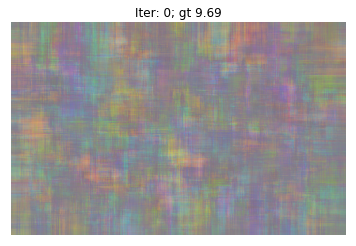

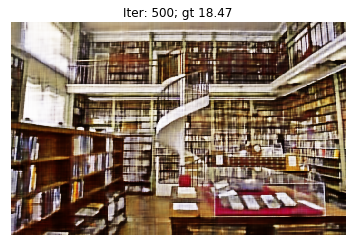

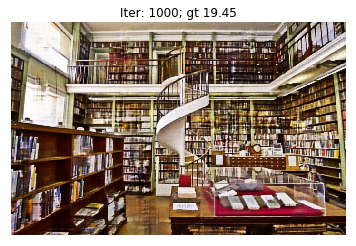

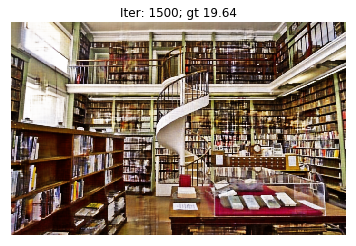

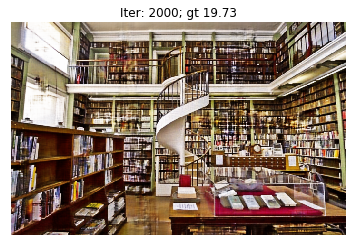

...

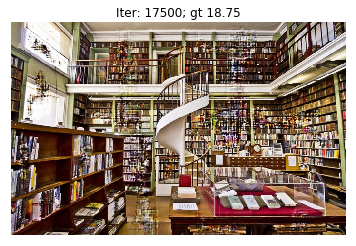

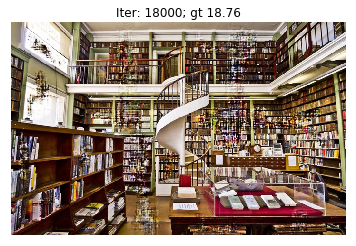

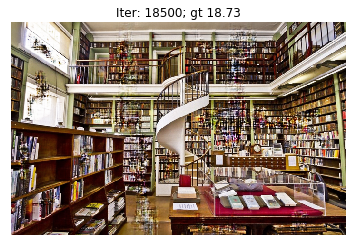

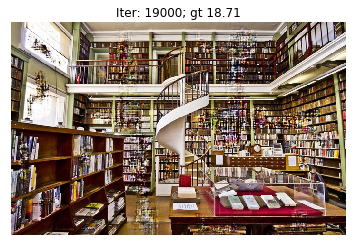

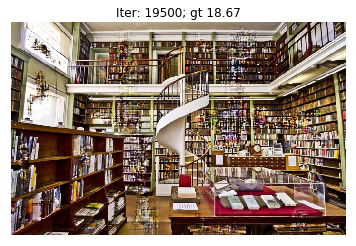

In [5]:
num_iter = 20000
check_point = 3000

reg_noise_std = 1./30

net = skip(
    input_depth, output_depth,
    num_channels_down = [16, 32, 64, 128, 128, 128][:num_layers],
    num_channels_up   = [16, 32, 64, 128, 128, 128][:num_layers],
    num_channels_skip = [0]*num_layers,
    upsample_mode='nearest',
    # downsample_mode='avg',
    need1x1_up = False,
    filter_size_down=5, 
    filter_size_up=3,
    filter_skip_size = 1,
    need_sigmoid=True, 
    need_bias=True, 
    pad='reflection', 
    act_fun='LeakyReLU').type(dtype)


net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

# save tmp PSNR for different learning strategies
fancy_sgd_psnr_list = [] # psnr between sgd out and gt
fancy_sgd_expm_psnr_list = []

out_avg = None # moving average
fancy_sgd_out = None
fancy_sgd_expm_out = None

i = 0
def closure_fancy_sgd():

    global i, out_avg, fancy_sgd_out, fancy_sgd_expm_out, check_point

    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    out = net(net_input)
    # moving average
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)


    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()

    out_np = out.detach().cpu().numpy()[0]
    out_avg_np = out_avg.detach().cpu().numpy()[0]

    psrn_gt    = compare_psnr(img_np, out_np)
    psrn_gt_sm = compare_psnr(img_np, out_avg_np)    
    fancy_sgd_psnr_list.append(psrn_gt)
    fancy_sgd_expm_psnr_list.append(psrn_gt_sm)

    # fancy sgd at 11000th iter
    if i == check_point - 1:
       fancy_sgd_out = out_np 
       fancy_sgd_expm_out = out_avg_np

    if np.mod(i, 500) == 0:
        np_plot(out.detach().cpu().numpy()[0], 'Iter: %d; gt %.2f' % (i, psrn_gt))

    i += 1
    return total_loss

    ## Optimizing 
print('Starting optimization with ADAM')
optimizer = torch.optim.Adam(net.parameters(), lr=LR)
for j in range(num_iter):
    optimizer.zero_grad()
    closure_fancy_sgd()
    optimizer.step()

### SGLD 

library: 2.08e-08
Starting optimization with SGLD


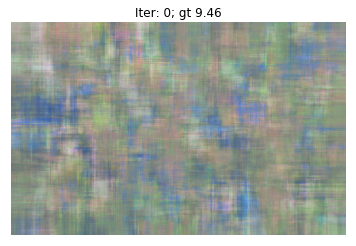

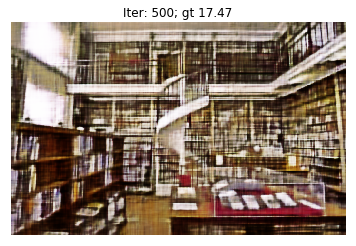

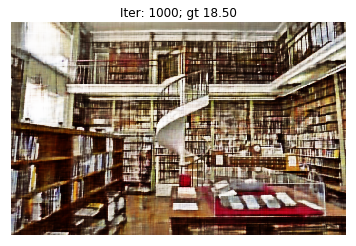

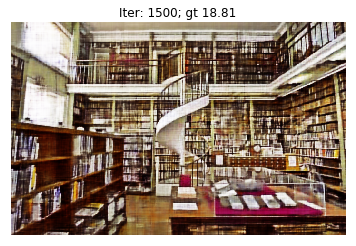

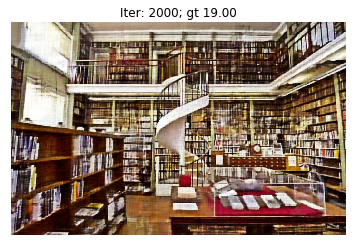

...

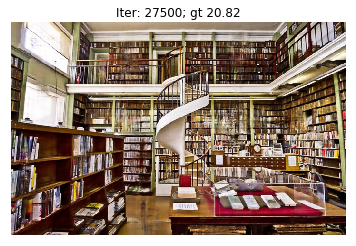

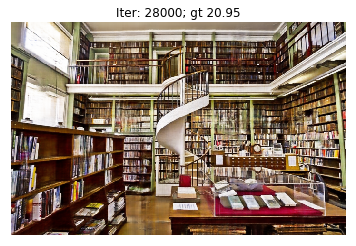

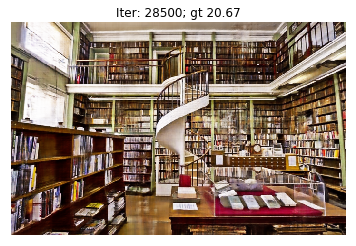

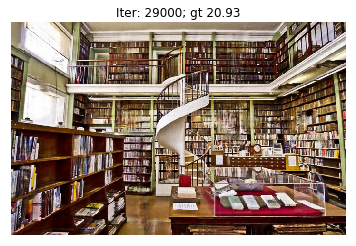

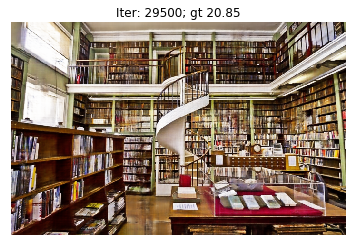

In [8]:

## cache samples from SGLD posterior
dirname_samples = dirname + '/samples/'
if not os.path.exists(dirname_samples):
    os.makedirs(dirname_samples, exist_ok=True)

## SGLD
def add_noise(model):
    for n in [x for x in model.parameters() if len(x.size()) == 4]:
        noise = torch.randn(n.size())*param_noise_sigma*learning_rate
        noise = noise.type(dtype)
        n.data = n.data + noise

def cache_sample(iteration, data):
    with open(dirname_samples + '/%d'%iteration, 'wb') as f:
        cPickle.dump(data, f)


num_iter = 30000
burnin_iter = 20000
MCMC_iter = 50
param_noise_sigma = 2
reg_noise_std = 1./30


# weight_decay
image_size = img_np.shape[1] * img_np.shape[2]
weight_decay = 5e-8 * (512 * 512) / image_size / 2
print('%s: %.2e' % (ffname, weight_decay))

samples = []

net = skip(
    input_depth, output_depth,
    num_channels_down = [16, 32, 64, 128, 128, 128][:num_layers],
    num_channels_up   = [16, 32, 64, 128, 128, 128][:num_layers],
    num_channels_skip = [0]*num_layers,
    upsample_mode='nearest',
    # downsample_mode='avg',
    need1x1_up = False,
    filter_size_down=5, 
    filter_size_up=3,
    filter_skip_size = 1,
    need_sigmoid=True, 
    need_bias=True, 
    pad='reflection', 
    act_fun='LeakyReLU').type(dtype)


net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

# save tmp PSNR for different learning strategies
sgld_psnr_list = [] # psnr between sgld out and gt
sgld_psnr_list2 = []

sgld_mean = 0
i = 0
sample_count = 0

def closure_sgld():

    global i, sample_count, sgld_mean
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    out = net(net_input)
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()

    out_np = out.detach().cpu().numpy()[0]
    psrn_gt    = compare_psnr(img_np, out_np)
    sgld_psnr_list.append(psrn_gt)


    if np.mod(i, 500) == 0:
        np_plot(out.detach().cpu().numpy()[0], 'Iter: %d; gt %.2f' % (i, psrn_gt))

        
    if i > burnin_iter and np.mod(i, MCMC_iter) == 0:
        sgld_mean += out_np
        sample_count += 1.
        cache_sample(i, out_np)            

    i += 1
    return total_loss

## Optimizing 
print('Starting optimization with SGLD')
optimizer = torch.optim.Adam(net.parameters(), lr=LR, weight_decay = weight_decay)
for j in range(num_iter):
    optimizer.zero_grad()
    closure_sgld()
    optimizer.step()
    add_noise(net)

sgld_mean = sgld_mean / sample_count
sgld_mean_psnr = compare_psnr(img_np, sgld_mean)  

#### Uncertainty map

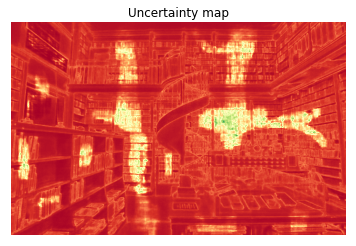

In [11]:
# generate uncertainty map
dir_samples = dirname + '/samples/'
samples = []
xiters = np.arange(20050, 30000, 50)
for i in xiters:
    file = dir_samples + '%d' % i
    with open(file, 'rb') as f:
        sample = cPickle.load(f)
        samples.append(sample)
uncertainty_map = np.mean(np.std(np.array(samples), axis=0), axis = 0)
# plt.imsave(output_dir + '/uncertainty_map.png', uncertainty_map, cmap=cm.RdYlGn)
np_plot(uncertainty_map, 'Uncertainty map', opt = 'map')

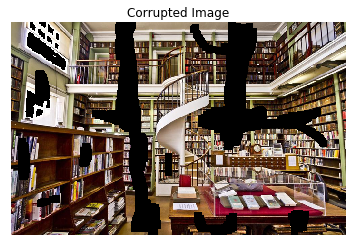

In [15]:
np_plot(img_np * img_mask_np, 'Corrupted Image')

### Compare SGD variants and SGLD

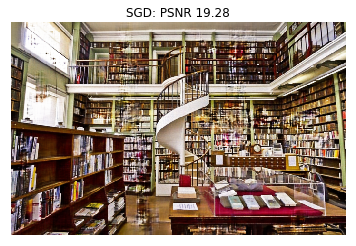

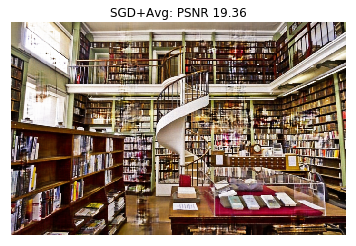

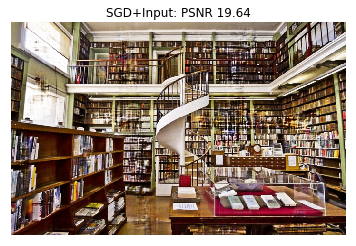

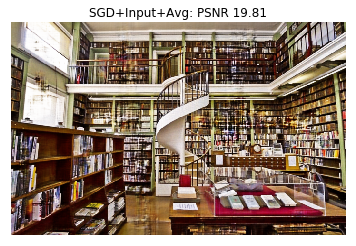

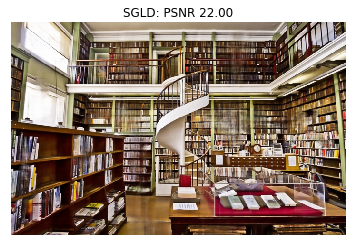

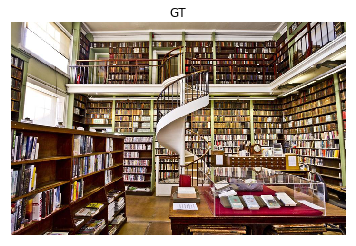

In [17]:
## VISUALIZE THE OUTPUT
np_plot(sgd_out, 'SGD: PSNR %.2f' % sgd_psnr_list[5000-1])
np_plot(sgd_expm_out, 'SGD+Avg: PSNR %.2f' % sgd_expm_psnr_list[5000-1])
np_plot(fancy_sgd_out, 'SGD+Input: PSNR %.2f' % fancy_sgd_psnr_list[3000-1])
np_plot(fancy_sgd_expm_out, 'SGD+Input+Avg: PSNR %.2f' % fancy_sgd_expm_psnr_list[3000-1])
np_plot(sgld_mean, 'SGLD: PSNR %.2f' %  sgld_mean_psnr)
np_plot(img_np, 'GT')